Import the important libraries

In [14]:
!pip install hdbscan
import pandas as pd
import folium 
import matplotlib.pyplot as plt
import numpy as np
import sklearn as sk
import matplotlib
from PIL import Image
from pylab import rcParams
from sklearn.cluster import DBSCAN
import sklearn.utils
from sklearn.preprocessing import StandardScaler
from ipywidgets import interact, interactive, fixed, interact_manual, widgets
import sklearn.utils
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from hdbscan import HDBSCAN
from sklearn.externals import joblib
%matplotlib inline

In [15]:
covid_data = pd.read_excel('/content/SurveyData.xlsx')
covid_data.head()

,Date,Latitude,Longitude
0,2021-04-03,21.223025,72.808018
1,2021-04-03,21.169480,72.790440
2,2021-04-03,21.195021,72.798539
3,2021-04-03,21.134580,72.772360
4,2021-04-03,21.166400,72.814610


[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.15632774e-06
  3.29072711e-06 7.84440151e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.15632774e-06
  3.29072711e-06 7.84440151e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.15632774e-06
  3.29072711e-06 7.84440151e-06]
 ...
 [0.00000000e+00 9.71008000e-02 1.17463948e-01 ... 8.88605784e-01
  8.88617464e-01 8.88617940e-01]
 [0.00000000e+00 1.17463948e-01 1.21191934e-01 ... 8.89301366e-01
  8.89313719e-01 8.89314231e-01]
 [0.00000000e+00 1.55371744e-01 1.68815175e-01 ... 8.89541312e-01
  8.89553898e-01 8.89554423e-01]]


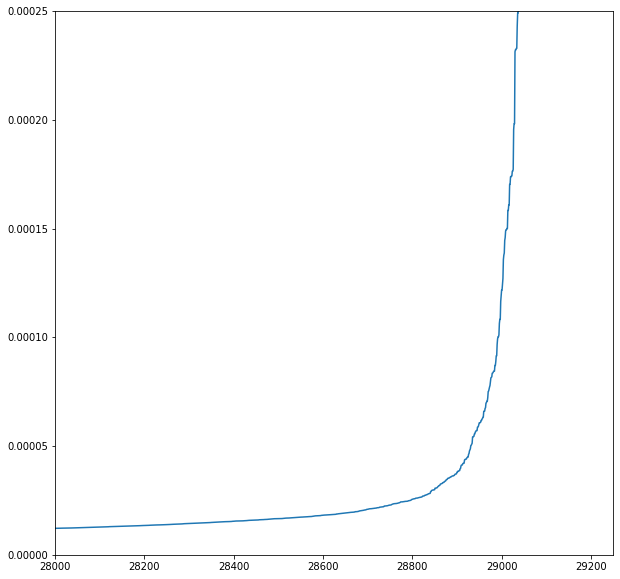

In [16]:
from sklearn.neighbors import NearestNeighbors
def optimum_eps_value(df_dates):
  neigh = NearestNeighbors(n_neighbors=50,metric = 'haversine')
  # date = df_dates['Date'][0]
  # print(date)
  # df_dates = df_dates[df_dates.Date == date]
  nbrs = neigh.fit(np.radians(df_dates[["Latitude","Longitude"]]))
  distances, indices = nbrs.kneighbors(np.radians(df_dates[["Latitude","Longitude"]]))
  distances = np.sort(distances, axis=0)
  print(distances)
  distances = distances[:,1]
  plt.figure(figsize=(10,10))
  plt.plot(distances)
  plt.xlim(28000,29250)
  plt.ylim(0 , .00025)
optimum_eps_value(covid_data)

In [17]:
def cluster_hdbscan(covid_data,epsilon = 0.0001):
  hdb_labels= HDBSCAN(min_cluster_size = 50, min_samples=40,
                gen_min_span_tree=True, metric = 'haversine', cluster_selection_epsilon=epsilon).fit_predict(np.radians(covid_data[['Latitude','Longitude']]))
  
  return hdb_labels

In [18]:
colors = [
    'red',
    'blue',
    'darkred',
    'lightred',
    'orange',
    'beige',
    'green',
    'darkgreen',
    'lightgreen',
    'darkblue',
    'lightblue',
    'purple',
    'darkpurple',
    'pink',
    'cadetblue',
    'lightgray',
    'black'
]

In [19]:
def show_cluster_map(index):
  global map
  global covid_data
  global colors
  covid_cumm_data = pd.DataFrame(columns = ['Latitude','Longitude','Date'])
  if index == 0:
    covid_cumm_data = covid_data[covid_data.Date == dates[index]]
  else :
    for idx in range(0,index):
      covid_data_date = covid_data[covid_data.Date == dates[idx]]
      covid_cumm_data = pd.concat([covid_cumm_data,covid_data_date])
  # print(covid_cumm_data)
  epsilon = 0.00015
  if covid_cumm_data is not None:
    covid_labels = cluster_hdbscan(covid_cumm_data,epsilon)
    covid_cumm_data['label'] = covid_labels
    # colors = plt.get_cmap('jet')(np.linspace(0.0,1,len(set(covid_labels))))
    for ix, row in covid_cumm_data.iterrows():
      if row['label'] == -1:
        c = 'gray'
      else :
        c =colors[int(row['label'])]
        # print(c)
      print(set(covid_labels))
      folium.CircleMarker(location = [row['Latitude'],row['Longitude']], radius = 0.8, color =c ).add_to(map)
  return map

In [20]:
lat_start_loc = 21.25761372772093
long_start_loc = 72.93488716344339
dates = list(set(covid_data['Date']))
map = folium.Map(location=[lat_start_loc,long_start_loc])
ii = interact(show_cluster_map, index=widgets.IntSlider(max=len(dates), min=0, step=1, value=0))

interactive(children=(IntSlider(value=0, description='index', max=14), Output()), _dom_classes=('widget-intera…

In [21]:
help(HDBSCAN)

Help on class HDBSCAN in module hdbscan.hdbscan_:

class HDBSCAN(sklearn.base.BaseEstimator, sklearn.base.ClusterMixin)
 |  HDBSCAN(min_cluster_size=5, min_samples=None, cluster_selection_epsilon=0.0, metric='euclidean', alpha=1.0, p=None, algorithm='best', leaf_size=40, memory=Memory(location=None), approx_min_span_tree=True, gen_min_span_tree=False, core_dist_n_jobs=4, cluster_selection_method='eom', allow_single_cluster=False, prediction_data=False, match_reference_implementation=False, **kwargs)
 |  
 |  Perform HDBSCAN clustering from vector array or distance matrix.
 |  
 |  HDBSCAN - Hierarchical Density-Based Spatial Clustering of Applications
 |  with Noise. Performs DBSCAN over varying epsilon values and integrates
 |  the result to find a clustering that gives the best stability over epsilon.
 |  This allows HDBSCAN to find clusters of varying densities (unlike DBSCAN),
 |  and be more robust to parameter selection.
 |  
 |  Parameters
 |  ----------
 |  min_cluster_size : i

In [61]:

def cluster_hdbscan_predict(covid_data,epsilon = 0.00000):
  hdb = HDBSCAN(min_cluster_size = 50, min_samples=40, metric = 'haversine', cluster_selection_epsilon=epsilon,prediction_data=True).fit(np.radians(covid_data[['Latitude','Longitude']]))
  print(hdb)
  return hdb

In [23]:
import hdbscan
def cluster_hdbscan_predict2(covid_data,hdb):
  pred_labels,_ = hdbscan.approximate_predict(hdb, np.radians(covid_data[['Latitude','Longitude']]))
  return pred_labels

In [28]:
hdb = cluster_hdbscan_predict(covid_data)
pred_labels, _ = hdbscan.approximate_predict(hdb,np.radians(covid_data[['Latitude','Longitude']]))

HDBSCAN(algorithm='best', allow_single_cluster=False, alpha=1.0,
        approx_min_span_tree=True, cluster_selection_epsilon=0.00015,
        cluster_selection_method='eom', core_dist_n_jobs=4,
        gen_min_span_tree=False, leaf_size=40,
        match_reference_implementation=False, memory=Memory(location=None),
        metric='haversine', min_cluster_size=50, min_samples=40, p=None,
        prediction_data=True)


In [65]:
centroid = pd.DataFrame(columns = ['Latitude','Longitude','Date','id'])
def show_cluster_map_predict(index):
  global map
  global covid_data
  global colors
  global dates
  hdb_model = None
  covid_labels = []
  covid_cumm_data = pd.DataFrame(columns = ['Latitude','Longitude','Date'])
  
  covid_cumm_data = covid_data[covid_data.Date == dates[0]]
  hdb_model = cluster_hdbscan_predict(covid_cumm_data)
  covid_labels = (hdb_model.labels_).tolist()
  print(len(covid_labels))
  
  for idx in range(1,index):
    
      covid_data_date = covid_data[covid_data.Date == dates[idx]]
      covid_cumm_data = pd.concat([covid_cumm_data,covid_data_date])
  covid_labels, _ = hdbscan.approximate_predict(hdb_model,np.radians(covid_cumm_data[['Latitude','Longitude']]))
  # covid_labels.append((covid_labels_1).tolist())
  # print(covid_cumm_data)
  epsilon = 0.00000
  print("hdb_model", hdb_model)
  
  covid_cumm_data['label'] = covid_labels
  # colors = plt.get_cmap('jet')(np.linspace(0.0,1,len(set(covid_labels))))
  for ix, row in covid_cumm_data.iterrows():
    if row['label'] == -1:
      c = 'gray'
    else :
      c =colors[int(row['label'])]
      # print(c)
    # print(set(covid_labels))
    folium.CircleMarker(location = [row['Latitude'],row['Longitude']], radius = 0.8, color =c ).add_to(map)
  
  if hdb_model is not None:

    for i in set(covid_labels):
      if i != -1:
        earth_radius = 6371000 # meters in earth
        centroids = hdb_model.weighted_cluster_centroid(i)
        distance_matrix = covid_cumm_data[covid_cumm_data.label == i]
        distance_matrix = np.radians(covid_cumm_data[["Latitude","Longitude"]]).to_numpy()
        # print(distance_matrix.shape)
        distance_matrix = distance_matrix - centroids
        variance  = np.multiply(distance_matrix,distance_matrix)
        variance = np.sum(variance)
        variance = variance /len(covid_cumm_data[covid_cumm_data.label == i])
        variance = (variance * earth_radius)/1000.0
        print("variance for the cluster {} is {}".format(i,variance))
        for centroid in centroids:
          print(centroid)
          folium.CircleMarker(location = [centroid], radius = 2, color = 'black' ).add_to(map)
    
  return map

In [66]:
lat_start_loc = 21.25761372772093
long_start_loc = 72.93488716344339
dates = list(set(covid_data['Date']))
map = folium.Map(location=[lat_start_loc,long_start_loc])
ii = interact(show_cluster_map_predict, index=widgets.IntSlider(max=len(dates)-1, min=0, step=1, value=0))

interactive(children=(IntSlider(value=0, description='index', max=13), Output()), _dom_classes=('widget-intera…